# Ghana Exploratory Data Analysis

In [89]:
# ! pip install pandas
# ! pip install geopandas
# ! pip install folium
# ! pip install matplotlib
# ! pip install pyogrio
# ! pip install fiona
# ! pip install scikit-learn
# ! pip install myst-nb
# ! pip install h5py
# ! pip install seaborn
# ! pip install datetime

     ---------------------------------------- 0.0/43.2 kB ? eta -:--:--
     ---------------------------------------- 43.2/43.2 kB 1.1 MB/s eta 0:00:00
   ---------------------------------------- 0.0/52.6 kB ? eta -:--:--
   ---------------------------------------- 52.6/52.6 kB 2.7 MB/s eta 0:00:00
   ---------------------------------------- 0.0/204.5 kB ? eta -:--:--
   ---------------------------------------- 204.5/204.5 kB 6.1 MB/s eta 0:00:00


In [1]:
import pandas as pd
import geopandas as gpd
import os
import folium
from folium.plugins import MarkerCluster
import numpy as np
import branca.colormap as cm
import matplotlib.pyplot as plt
import fiona
import sklearn
import h5py
import seaborn as sns
import pickle
from sklearn.neighbors import LocalOutlierFactor, NearestNeighbors, RadiusNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import jaccard_score
from sklearn.metrics.pairwise import haversine_distances
from scipy.stats import spearmanr
from datetime import datetime
from pyproj import Proj, transform

os.chdir(r"C:\Users\nial\OneDrive\ETH Zürich\Master Thesis")

### Load Data

Whole dataset

In [56]:
fields = ['pft_class', 'leaf_off_f', 'urban_pro','selected_a','sensitivit'
          ,'agbd', 'agbd_se', 'rh98', 'date', 'geometry']

df_ghana = gpd.read_file('GEDI_Ghana.geojson'
                         , driver = 'GeoJSON'
                         )
                         # , engine='pyogrio')

Random subsample of 9,995 rows

In [2]:
df_ghana_subsample = gpd.read_file('df_ghana_subsample.geojson'
                         , driver = 'GeoJSON')
                         # , engine='pyogrio')

In [8]:
sorted(df_ghana_subsample.columns.tolist())


['agbd',
 'agbd_se',
 'beam',
 'date',
 'doy_cos',
 'doy_sin',
 'elev_lowes',
 'geometry',
 'lat_cos',
 'lat_lowest',
 'lat_sin',
 'leaf_off_f',
 'lon_cos',
 'lon_lowest',
 'lon_sin',
 'pattern',
 'pft_class',
 'pft_class_group',
 'region_cla',
 'rh98',
 'selected_a',
 'sensitivit',
 'shot_numbe',
 'solar_elev',
 'urban_prop']

In [12]:
df_ghana_subsample['pattern']

0       2020094211753_O07418_03_T03338_02_V002
1       2019303010145_O04986_02_T00516_02_V002
2       2021348161218_O17025_03_T07454_02_V002
3       2020327145859_O11026_02_T09559_02_V002
4       2023010183916_O23106_02_T03056_02_V002
                         ...                  
9990    2020252203449_O09867_02_T06560_02_V002
9991    2020135185408_O08052_02_T03561_02_V002
9992    2019159201310_O02764_03_T02726_02_V002
9993    2023075170425_O24113_02_T00409_02_V002
9994    2021131192811_O13664_02_T01587_02_V002
Name: pattern, Length: 9995, dtype: object

In [14]:
df_ghana_subsample['rh98']

0        9.200005
1        9.189999
2       13.389993
3        2.349996
4       18.479991
          ...    
9990     5.309996
9991    15.189997
9992     7.080010
9993     7.450005
9994     4.299999
Name: rh98, Length: 9995, dtype: float64

See unique columns:

In [ ]:
df_ghana.columns

Index(['pft_class', 'region_cla', 'leaf_off_f', 'urban_prop', 'agbd',
       'agbd_se', 'beam', 'elev_lowes', 'lat_lowest', 'lon_lowest',
       'selected_a', 'shot_numbe', 'sensitivit', 'solar_elev', 'rh98',
       'pattern', 'doy_sin', 'doy_cos', 'date', 'lat_cos', 'lat_sin',
       'lon_cos', 'lon_sin', 'geometry'],
      dtype='object')

Number of measurements by column

In [ ]:
df_ghana_subsample['pft_class'].value_counts()

pft_class
6    4782
2    3288
4     840
8     664
7     402
9      24
Name: count, dtype: int64

Median standard error by plant functional type (pft)

In [24]:
df_se_medians = df_ghana_subsample.groupby('pft_class')['agbd_se'].median().reset_index()
df_se_medians.rename(columns={'agbd_se': 'median_agbd_se'}, inplace=True)

df_se_medians.head(10)

,pft_class,median_agbd_se
0,2,17.132369
1,4,4.178562
2,6,2.990576
3,7,3.005250
4,8,2.998887
5,9,4.213624


Note: we can infer the prediction stratum from pft_class, since: 

_"Footprint AGBD is generated for 32 combinations of plant functional type (PFT) and geographic world region using 13 linear models"_

### Plot Folium Map of data

In [ ]:
# prepare dict of colours
colour_crit = 'pft_class'
index = sorted([i for i in df_ghana_subsample[colour_crit].unique()])
colour_list = ['red', 'yellow', 'pink', 'chartreuse', 'orange','purple','blue']
colour_dict = {index:colour for index, colour in zip(index, colour_list)}

# Ghana tile
ghana_map = folium.Map(location=[7.9465, -1.0232], zoom_start=7)

# colour scale
# linear = cm.LinearColormap(colour_list, vmin=df_ghana[colour_crit].min(), vmax=df_ghana[colour_crit].max())
# step = cm.StepColormap(colour_list, index=index)

# plot rows
for _, row in df_ghana_subsample.iterrows():
    
    geom = row['geometry']
    colour_index = row[colour_crit]

    # if colour == 2: continue
    
    folium.CircleMarker(
          location=[geom.y, geom.x]
        # , popup=...
        , radius=3
        , fill=True
        , color=colour_dict[colour_index]
    ).add_to(ghana_map)

legend_html = '''
     <div style="position: fixed; 
                 bottom: 50px; left: 50px; width: 130px; height: 180px; 
                 border:2px solid grey; z-index:9999; font-size:14px;
                 background-color: white;
                 ">&nbsp; Legend <br>
                 &nbsp; PFT 2 &nbsp; <i class="fa fa-circle 
                                  fa-1x" style="color:red"></i><br>
                 &nbsp; PFT 4 &nbsp; <i class="fa fa-circle 
                                  fa-1x" style="color:yellow"></i><br>
                 &nbsp; PFT 6 &nbsp; <i class="fa fa-circle 
                                  fa-1x" style="color:pink"></i><br>
                 &nbsp; PFT 7 &nbsp; <i class="fa fa-circle 
                                  fa-1x" style="color:chartreuse"></i><br>
                 &nbsp; PFT 8 &nbsp; <i class="fa fa-circle 
                                  fa-1x" style="color:orange"></i><br>
                 &nbsp; PFT 9 &nbsp; <i class="fa fa-circle 
                                  fa-1x" style="color:purple"></i><br>
                 &nbsp; PFT 11 &nbsp; <i class="fa fa-circle 
                                  fa-1x" style="color:blue"></i>
      </div>
     '''

ghana_map.get_root().html.add_child(folium.Element(legend_html))

# Display the map
ghana_map

In [132]:
# df_ghana_subsample = df_ghana.sample(n=10000, replace=False)
# df_ghana_subsample = df_ghana_subsample.sample(frac=1, replace=False, random_state=42, axis=0)
# df_ghana_subsample.drop_duplicates(inplace=True)
df_ghana_subsample.to_file("df_ghana_subsample.geojson", driver='GeoJSON')

### Plot standard errors against agbd

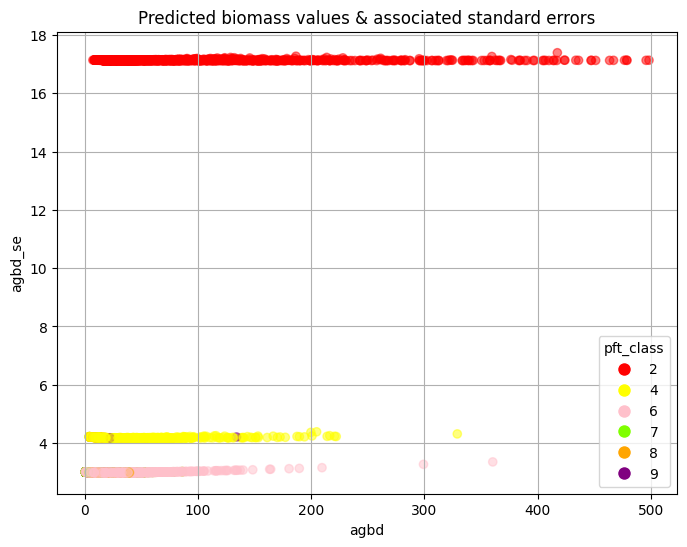

In [ ]:
scatter_colours = [colour_dict.get(colour_index, 'black') for colour_index in df_ghana_subsample[colour_crit]]

plt.figure(figsize=(8, 6))
plt.scatter(df_ghana_subsample['agbd'], df_ghana_subsample['agbd_se'], color=scatter_colours, alpha=0.5, label='Data')

p = np.polyfit(df_ghana_subsample['agbd'], df_ghana_subsample['agbd_se'], deg=3)
x_values = np.linspace(df_ghana_subsample['agbd'].min(), df_ghana_subsample['agbd'].max(), 100)
y_values = np.polyval(p, x_values)
# plt.plot(x_values, y_values, color='red', label='Cubic Line of Best Fit')

plt.title('Predicted biomass values & associated standard errors')
plt.xlabel('agbd')
plt.ylabel('agbd_se')

legend_handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor=color, markersize=10, label=label)
                  for label, color in colour_dict.items()]
plt.legend(handles=legend_handles, title=colour_crit)

plt.grid(True)
plt.show()

In [ ]:
len(df_ghana_subsample['agbd_se'].unique())

4501

Recall that the standard error calculation is 

$$ \text{SE}_i = \sqrt{ \text{MSE}_k + \mathbf{X}_i \text{Cov}( \beta) \mathbf{X}_i^T } $$

Where:

* $i$ indexes a footprint
* $k$ indexes the stratum containing $i$
* $\text{MSE}_k$ is the $\text{MSE}$ from the linear regression model applied to prediction stratum $k$
* $\mathbf{X}_i$ is the row vector of relative height (RH) metrics for GEDI footprint $i$
* $\text{Cov}( \beta)$ is the covariance matrix for model parameters in transformed units

We observe in the plot that for this subset of data, the AGBD standard errors are clustered around three values. Yet there are 4501 unique `agbd_se` values. My hypothesis is that in the standard error calculation, the $\text{MSE}_k$ term dominates while the term involving $\mathbf{X}_i$ only makes a negligible contribution. Hence the `agbd_se` mainly indicates the goodness of fit of the model converting `rh98` to `agbd`. 

However, $\text{SE}_i$ is not back-transformed to the original units, so it is hard to interpret anything from the value itself.

Note how PFT classes are grouped:

* ENT: class 1
* EBT: class 2
* DNT: class 3 (not in Africa)
* DBT: class 4
* GSW: classes 5, 6, 11

`df_se_medians` suggests that class 2 is separate from the rest, classes 4 & 9 are together, and classes 6, 7 and 8 are together.

In [25]:
df_se_medians

,pft_class,median_agbd_se
0,2,17.132369
1,4,4.178562
2,6,2.990576
3,7,3.005250
4,8,2.998887
5,9,4.213624


### Outlier Detection Experiment

Aim: we will deploy outlier detection methodologies from `scikit-learn` to get a feel for which rows the methods consider outliers.

We begin with the `LocalOutlierFactor()`, a density-based approach to detecting outliers. Per the sklearn website:

_The anomaly score of each sample is called the Local Outlier Factor. It measures the local deviation of the density of a given sample with respect to its neighbors. It is local in that the anomaly score depends on how isolated the object is with respect to the surrounding neighborhood. More precisely, locality is given by k-nearest neighbors, whose distance is used to estimate the local density. By comparing the local density of a sample to the local densities of its neighbors, one can identify samples that have a substantially lower density than their neighbors. These are considered outliers._

Note that the `LocalOutlierFactor()` takes in numeric values only. We will reduce the dataframe to categorical and numerical columns:

Data Processing

In [92]:
# drop non-feature columns
drop_cols = [  'pattern', 'geometry', 'region_cla', 'elev_lowes', 'lat_lowest', 'lon_lowest', 'shot_numbe'
             , 'doy_sin', 'doy_cos', 'date', 'lat_cos', 'lat_sin', 'lon_cos', 'lon_sin']
df_ghana_subsample_lof = df_ghana_subsample.drop(drop_cols, axis=1)

# group pft_class
# {class:class_group}. class_group identifier = lowest number of class in group
class_group_dict = {2:2, 4:4, 9:4, 6:6, 7:6, 8:6}
df_ghana_subsample_lof['pft_class_group'] = df_ghana_subsample_lof.apply(lambda row: class_group_dict[row['pft_class']], axis=1)
df_ghana_subsample_lof.drop('pft_class', axis=1, inplace=True)

# one-hot encode the categorical columns
cat_cols = ['pft_class_group', 'beam', 'selected_a', 'leaf_off_f']
df_ghana_subsample_lof = pd.get_dummies(df_ghana_subsample_lof, columns=cat_cols)

Classify outliers

In [94]:
# fit LOF
clf = LocalOutlierFactor(n_jobs=20)
anomaly_clf = clf.fit_predict(df_ghana_subsample_lof)
anomaly_score_clf = clf.negative_outlier_factor_

# compute % classified as anomalies
perc_anom = (100 * sum(anomaly_clf == -1) / len(anomaly_clf))
print(f"{perc_anom:.2f}% of values are categorised as anomalies")

0.80% of values are categorised as anomalies


`sklearn` does not explicitly provide variable importance scores for LOF analysis. Hence we will fit a logisitic regression model to determine which variables are most important for determining outliers.

In [28]:
log_reg = LogisticRegression(penalty='l1', solver='liblinear')
log_reg.fit(df_ghana_subsample_lof, anomaly_clf)

LogisticRegression(penalty='l1', solver='liblinear')

View coefficient estimates of logistic regression fit

In [44]:
lr_coeffs = [item for sublist in log_reg.coef_.tolist() for item in sublist]
colnames = [c for c in log_reg.feature_names_in_]
lr_coeffs = {var:round(coef,3) for var, coef in zip(colnames,lr_coeffs)}

# sort in descending order of absolute value
# lr_coeffs = dict(sorted(lr_coeffs.items(), key=lambda item: abs(item[1]), reverse=True))
lr_coeffs

{'urban_prop': -0.302,
 'agbd': 0.036,
 'agbd_se': -0.121,
 'sensitivit': 3.73,
 'solar_elev': -0.018,
 'rh98': -0.031,
 'pft_class_group_2': 0.796,
 'pft_class_group_4': -0.924,
 'pft_class_group_6': 0.0,
 'beam_5': 0.026,
 'beam_6': 0.0,
 'beam_8': -0.148,
 'beam_11': 0.223,
 'selected_a_1': 0.0,
 'selected_a_2': 1.084,
 'selected_a_5': 0.0,
 'leaf_off_f_0': 1.799,
 'leaf_off_f_255': 0.0}

We should also consider how many non-zero observations we have per column:

In [95]:
non_zero_counts = df_ghana_subsample_lof.astype(bool).sum(axis=0)
non_zero_counts

urban_prop             69
agbd                 9995
agbd_se              9995
sensitivit           9995
solar_elev           9995
rh98                 9995
pft_class_group_2    3287
pft_class_group_4     864
pft_class_group_6    5844
beam_5               2224
beam_6               2245
beam_8               2485
beam_11              3041
selected_a_1         7841
selected_a_2         2033
selected_a_5          121
leaf_off_f_0         9897
leaf_off_f_255         98
dtype: int64

* `urban_prop` has a surprisingly large coefficient, given it is only non-zero for 69 / 10000 observations. 
* `agbd` and `agb_se` are not useful predictors
* `sensivity`, `leaf_off` and `pft_class_group` seem to be the most relevant predictors

###  Compare LOF classification with k-1 predictors

We will classify outliers with every subset of $k-1$ predictors. Then, we will rank the predictors by Jaccard score: $\frac{|A \cap B|}{|A \bigcup B|}$, where $A$ and $B$ are the set of indices of outliers classified with $k$ and $k-1$ predictors respectively.

In [51]:
# custom Jaccard score allows for differently-sized lists

def jaccard(list1, list2):
    intersection = len(list(set(list1).intersection(list2)))
    union = (len(list1) + len(list2)) - intersection
    return float(intersection) / union

In [52]:
anom_indices = df_ghana_subsample_lof.index[anomaly_clf == -1].tolist()
j_scores = dict()

for c in colnames:

    # omit predictor
    X = df_ghana_subsample_lof.drop(columns=[c])

    # fit LOF classifier
    clf_km1 = LocalOutlierFactor(n_jobs=20)
    anomaly_km1 = clf.fit_predict(X)
    anom_indices_km1 = df_ghana_subsample_lof.index[anomaly_km1 == -1].tolist()

    # store Jaccard score
    j_score = jaccard(anom_indices, anom_indices_km1)
    j_scores.update([(c,j_score)])

# j_scores = dict(sorted(j_scores.items(), key=lambda item: abs(item[1]), reverse=False))
j_scores

{'urban_prop': 0.36904761904761907,
 'agbd': 0.40625,
 'agbd_se': 0.875,
 'sensitivit': 1.0,
 'solar_elev': 0.09742120343839542,
 'rh98': 0.9146341463414634,
 'pft_class_group_2': 0.9753086419753086,
 'pft_class_group_4': 0.975,
 'pft_class_group_6': 0.9629629629629629,
 'beam_5': 0.9411764705882353,
 'beam_6': 0.963855421686747,
 'beam_8': 0.9080459770114943,
 'beam_11': 0.8888888888888888,
 'selected_a_1': 0.975609756097561,
 'selected_a_2': 0.975609756097561,
 'selected_a_5': 1.0,
 'leaf_off_f_0': 0.9875,
 'leaf_off_f_255': 0.9875}

There is no significant rank correlation between the absolute value of a coefficient from logistic regression and the k-to-(k-1) Jaccard score. Personally, I prefer the latter measurement, since we have not standardised units in the log fit.

In [59]:
rank_corr = spearmanr(list(j_scores.values()), [abs(v) for v in lr_coeffs.values()])
rank_corr

SignificanceResult(statistic=0.07624321315473259, pvalue=0.7636525773420824)

Sort the Jaccard scores in ascending value order:

In [60]:
j_scores_sorted = dict(sorted(j_scores.items(), key=lambda item: abs(item[1]), reverse=False))
j_scores_sorted

{'solar_elev': 0.09742120343839542,
 'urban_prop': 0.36904761904761907,
 'agbd': 0.40625,
 'agbd_se': 0.875,
 'beam_11': 0.8888888888888888,
 'beam_8': 0.9080459770114943,
 'rh98': 0.9146341463414634,
 'beam_5': 0.9411764705882353,
 'pft_class_group_6': 0.9629629629629629,
 'beam_6': 0.963855421686747,
 'pft_class_group_4': 0.975,
 'pft_class_group_2': 0.9753086419753086,
 'selected_a_1': 0.975609756097561,
 'selected_a_2': 0.975609756097561,
 'leaf_off_f_0': 0.9875,
 'leaf_off_f_255': 0.9875,
 'sensitivit': 1.0,
 'selected_a_5': 1.0}

### Plot outliers

We will visualize where in Ghana are the outliers predicted by `LOF()`.

Merge anomaly categorisation with data

In [98]:
df_ghana_subsample_lof['anomaly_clf'] = anomaly_clf
df_ghana_subsample_lof['geometry'] = df_ghana_subsample['geometry']

In [202]:
# prepare dict of colours
colour_crit = 'anomaly_clf'
index = sorted([i for i in df_ghana_subsample_lof[colour_crit].unique()])
colour_list = ['red', 'green']
colour_dict = {index:colour for index, colour in zip(index, colour_list)}

# Ghana tile
ghana_map = folium.Map(location=[7.9465, -1.0232], zoom_start=7)

# colour scale
# linear = cm.LinearColormap(colour_list, vmin=df_ghana[colour_crit].min(), vmax=df_ghana[colour_crit].max())
# step = cm.StepColormap(colour_list, index=index)

# plot rows
for _, row in df_ghana_subsample_lof.iterrows():
    
    geom = row['geometry']
    colour_index = row[colour_crit]

    # if colour == 2: continue
    
    folium.CircleMarker(
          location=[geom.y, geom.x]
        # , popup=...
        , radius=2 if colour_index == 1 else 3
        , fill=True
        , color=colour_dict[colour_index]
    ).add_to(ghana_map)

legend_html = '''
     <div style="position: fixed; 
                 bottom: 50px; left: 50px; width: 130px; height: 180px; 
                 border:2px solid grey; z-index:9999; font-size:14px;
                 background-color: white;
                 ">&nbsp; Legend <br>
                 &nbsp; Not anomaly &nbsp; <i class="fa fa-circle 
                                  fa-1x" style="color:green"></i><br>
                 &nbsp; Anomaly &nbsp; <i class="fa fa-circle 
                                  fa-1x" style="color:red"></i><br>
      </div>
     '''

ghana_map.get_root().html.add_child(folium.Element(legend_html))

# Display the map
ghana_map

From zooming in on a few points, it seems like urban proportion is a big determinant of outliers. Perhaps we can check the distribution of urban proportion values in the whole dataset vs in the points classed as outliers.

In [96]:
df_ghana_subsample_lof.columns

Index(['urban_prop', 'agbd', 'agbd_se', 'sensitivit', 'solar_elev', 'rh98',
       'pft_class_group_2', 'pft_class_group_4', 'pft_class_group_6', 'beam_5',
       'beam_6', 'beam_8', 'beam_11', 'selected_a_1', 'selected_a_2',
       'selected_a_5', 'leaf_off_f_0', 'leaf_off_f_255'],
      dtype='object')

In [211]:
prop_urban = np.mean(df_ghana_subsample_lof['urban_prop'])
prop_urban_outlier = np.mean(df_ghana_subsample_lof['urban_prop'][df_ghana_subsample_lof['anomaly_clf']== -1])
prop_urban, prop_urban_outlier

(0.1309, 12.425)

In [99]:
prop_leaf_off = np.mean(df_ghana_subsample_lof['leaf_off_f_255'])
prop_leaf_off_outlier = np.mean(df_ghana_subsample_lof['leaf_off_f_255'][df_ghana_subsample_lof['anomaly_clf']== -1])
prop_leaf_off, prop_leaf_off_outlier

(0.009804902451225613, 0.0375)

In [103]:
rh98_mean = np.mean(df_ghana_subsample_lof['rh98'])
rh98_mean_outlier = np.mean(df_ghana_subsample_lof['rh98'][df_ghana_subsample_lof['anomaly_clf']== -1])
rh98_mean, rh98_mean_outlier

(8.168684673057358, 6.245374380760938)

In [106]:
agbd_mean = np.mean(df_ghana_subsample_lof['agbd'])
agbd_mean_outlier = np.mean(df_ghana_subsample_lof['agbd'][df_ghana_subsample_lof['anomaly_clf']== -1])
agbd_mean, agbd_mean_outlier

(27.697210691951973, 16.582802568750004)

In [108]:
solar_elev_mean = np.mean(df_ghana_subsample_lof['solar_elev'])
solar_elev_mean_outlier = np.mean(df_ghana_subsample_lof['solar_elev'][df_ghana_subsample_lof['anomaly_clf']== -1])
solar_elev_mean, solar_elev_mean_outlier

(-15.464021642463132, -4.080479487500002)

In [216]:
print(f"The mean proportion of footprints in urban areas is {prop_urban_outlier / prop_urban:.2f} times higher in the outlier group than in the whole dataset")

The mean proportion of footprints in urban areas is 94.92 times higher in the outlier group than in the whole dataset


In [100]:
print(f"The mean proportion of footprints with leaf off flag is {prop_leaf_off_outlier / prop_leaf_off:.2f} times higher in the outlier group than in the whole dataset")

The mean proportion of footprints with leaf off flag is 3.82 times higher in the outlier group than in the whole dataset


In [105]:
df_ghana_subsample['leaf_off_f'].unique()

array([  0, 255], dtype=int64)

Thinking about it, it would be more interesting to estimate outliers with the explanatory variables masked, _then_ cross-compare and see which variables are responsible for the outlier-ness. Also, it would be more interesting to use the geographic structure of the data. I.e., neighbours are not points with similar values, but points that are geographically close together. Could we do some outlier detection which only considers the `agbd` and uses geographic proximity?

In [3]:
df_ghana_subsample.columns

Index(['pft_class', 'region_cla', 'leaf_off_f', 'urban_prop', 'agbd',
       'agbd_se', 'beam', 'elev_lowes', 'lat_lowest', 'lon_lowest',
       'selected_a', 'shot_numbe', 'sensitivit', 'solar_elev', 'rh98',
       'pattern', 'doy_sin', 'doy_cos', 'date', 'lat_cos', 'lat_sin',
       'lon_cos', 'lon_sin', 'geometry'],
      dtype='object')

In [9]:
# copy warning off
pd.options.mode.chained_assignment = None

df_ghana_outlier = df_ghana_subsample[['agbd', 'geometry']]
df_ghana_outlier['lon'] = df_ghana_outlier['geometry'].x
df_ghana_outlier['lat'] = df_ghana_outlier['geometry'].y
df_ghana_outlier.drop('geometry', axis=1, inplace=True)

coords = df_ghana_outlier[['lon','lat']]
D = haversine_distances(coords, coords)

`LocalOutlierFactor()` is not a good fit for this task. The determination of outliers is based on local density. Given the lat, lon coordinates of the points, `agbd` is only incorporated as a third (spatial) dimension, as opposed to a 'value' distinct from a 'geometry'. I think model-based outlier estimation is the way to include 'value' information distinctly from 'geometry'. Using `LOF()`, points that are geographically isolated by chance will be considered outliers.

In [12]:
lof = LocalOutlierFactor(n_neighbors=20, n_jobs=20)
anomaly_lof = lof.fit_predict(df_ghana_outlier)
anomaly_score_lof = lof.negative_outlier_factor_

# compute % classified as anomalies
perc_anom = (100 * sum(anomaly_lof  == -1) / len(anomaly_lof))
print(f"{perc_anom}% of values are categorised as anomalies")

0.13% of values are categorised as anomalies


In [15]:
df_ghana_outlier['anomaly_clf'] = anomaly_lof
df_ghana_outlier['geometry'] = df_ghana_subsample['geometry']

# prepare dict of colours
colour_crit = 'anomaly_clf'
index = sorted([i for i in df_ghana_outlier[colour_crit].unique()])
colour_list = ['red', 'green']
colour_dict = {index:colour for index, colour in zip(index, colour_list)}

# Ghana tile
ghana_map = folium.Map(location=[7.9465, -1.0232], zoom_start=7)

# colour scale
# linear = cm.LinearColormap(colour_list, vmin=df_ghana[colour_crit].min(), vmax=df_ghana[colour_crit].max())
# step = cm.StepColormap(colour_list, index=index)

# plot rows
for _, row in df_ghana_outlier.iterrows():
    
    geom = row['geometry']
    colour_index = row[colour_crit]

    # if colour == 2: continue
    
    folium.CircleMarker(
          location=[geom.y, geom.x]
        # , popup=...
        , radius=2 if colour_index == 1 else 3
        , fill=True
        , color=colour_dict[colour_index]
    ).add_to(ghana_map)

legend_html = '''
     <div style="position: fixed; 
                 bottom: 50px; left: 50px; width: 130px; height: 180px; 
                 border:2px solid grey; z-index:9999; font-size:14px;
                 background-color: white;
                 ">&nbsp; Legend <br>
                 &nbsp; Not anomaly &nbsp; <i class="fa fa-circle 
                                  fa-1x" style="color:green"></i><br>
                 &nbsp; Anomaly &nbsp; <i class="fa fa-circle 
                                  fa-1x" style="color:red"></i><br>
      </div>
     '''

ghana_map.get_root().html.add_child(folium.Element(legend_html))

# Display the map
ghana_map

In [ ]:
df_ghana_outlier['anomaly_clf'] = anomaly_lof
df_ghana_outlier['geometry'] = df_ghana_subsample['geometry']

# prepare dict of colours
colour_crit = 'anomaly_clf'
index = sorted([i for i in df_ghana_outlier[colour_crit].unique()])
colour_list = ['red', 'green']
colour_dict = {index:colour for index, colour in zip(index, colour_list)}

# Ghana tile
ghana_map = folium.Map(location=[7.9465, -1.0232], zoom_start=7)

# colour scale
# linear = cm.LinearColormap(colour_list, vmin=df_ghana[colour_crit].min(), vmax=df_ghana[colour_crit].max())
# step = cm.StepColormap(colour_list, index=index)

# plot rows
for _, row in df_ghana_outlier.iterrows():
    
    geom = row['geometry']
    colour_index = row[colour_crit]

    # if colour == 2: continue
    
    folium.CircleMarker(
          location=[geom.y, geom.x]
        # , popup=...
        , radius=2 if colour_index == 1 else 3
        , fill=True
        , color=colour_dict[colour_index]
    ).add_to(ghana_map)

legend_html = '''
     <div style="position: fixed; 
                 bottom: 50px; left: 50px; width: 130px; height: 180px; 
                 border:2px solid grey; z-index:9999; font-size:14px;
                 background-color: white;
                 ">&nbsp; Legend <br>
                 &nbsp; Not anomaly &nbsp; <i class="fa fa-circle 
                                  fa-1x" style="color:green"></i><br>
                 &nbsp; Anomaly &nbsp; <i class="fa fa-circle 
                                  fa-1x" style="color:red"></i><br>
      </div>
     '''

ghana_map.get_root().html.add_child(folium.Element(legend_html))

# Display the map
ghana_map

The outlier detection is very conservative, and there is no obvious pattern to which points are classified as outliers. Some look more spatially isolated than their neighbours, but most urban points slip through the net. 

In [49]:
sum(gdf['status'] == 'c')

10

Identifying neighbours within a radius more or less works. However, the method displays some erroneous behaviour. Longitude is seemingly discounted in the distance computation, in the sense that points further away in longitude are included over points an equal distance in latitude. 

#### Implementation Examples

In this workflow, we will:

* Divide up the dataframe by PFT values
* Perform anomaly detection on each PFT stratum
* Compare the empirical distribution of:
    * Features for anomalous points
    * Features for non-anomalous points

In [14]:
# define PFT classes
class_group_dict = {2:2, 4:4, 9:4, 6:6, 7:6, 8:6}
df_ghana_subsample['pft_class_group'] = df_ghana_subsample.apply(lambda row: class_group_dict[row['pft_class']], axis=1)

# it is important that all geometries are unique
geom_unique = len(df_ghana_subsample['geometry'].unique()) == len(df_ghana_subsample['geometry'])
print(f"It is {geom_unique} that all geometries are unique")

# partition dataframe by class group
df_ghana_ss_2 = df_ghana_subsample[df_ghana_subsample['pft_class_group'] == 2]
df_ghana_ss_4 = df_ghana_subsample[df_ghana_subsample['pft_class_group'] == 4]
df_ghana_ss_6 = df_ghana_subsample[df_ghana_subsample['pft_class_group'] == 6]

# perform anomaly detection
anom_ss_2 = algorithm(df_ghana_ss_2, theta=3, alg_no=2)
anom_ss_4 = algorithm(df_ghana_ss_4, theta=3, alg_no=2)
anom_ss_6 = algorithm(df_ghana_ss_6, theta=3, alg_no=2)

# report the number of outliers
print(f"{int(sum(anom_ss_2))} outliers recorded for PFT class group 2, out of {len(df_ghana_ss_2)} observations")
print(f"{int(sum(anom_ss_4))} outliers recorded for PFT class group 4, out of {len(df_ghana_ss_4)} observations")
print(f"{int(sum(anom_ss_6))} outliers recorded for PFT class group 6, out of {len(df_ghana_ss_6)} observations")

# save results
wd = r"C:\Users\nial\OneDrive\ETH Zürich\Master Thesis"
os.chdir(wd)

with open('anom_ss_2.pkl', 'wb') as file:
    pickle.dump(anom_ss_2, file)
    
with open('anom_ss_4.pkl', 'wb') as file:
    pickle.dump(anom_ss_4, file)

with open('anom_ss_6.pkl', 'wb') as file:
    pickle.dump(anom_ss_6, file)

It is True that all geometries are unique
273 outliers recorded for PFT class group 2, out of 3287 observations
41 outliers recorded for PFT class group 4, out of 864 observations
377 outliers recorded for PFT class group 6, out of 5844 observations


Compare distribution of features (outliers vs not). We begin with PFT class group 2.

In [254]:
anom_k = algorithm(gdf=df_ghana_subsample, alg_no=2, theta=2.5, r=5.0, nbr_method='knn')

In [255]:
sum(anom_k)

1687.0

In [3]:
def compare_dist(df:gpd.GeoDataFrame, outlier:np.ndarray, PFT: int, feature: str='sensitivit', mode: str='show'):
    """
    Plot overlapping histograms to compare feature distributions in the outlier vs non-outlier datasets.

    INPUTS:
    df: dataframe with feature values (gpd.GeoDataFrame or pd.DataFrame)
    outlier: outliers identified for df based on `agbd` (np.ndarray)
    PFT: PFT class group of data in df; 2, 4 or 6 (int)
    feature: feature in df of which to compare distributions (str)
    mode: 'save' or 'show'? (str)
    """
    # clear figure
    plt.clf()

    # define bins
    # bins = min(20, df[feature].nunique())
    bins = 20
    min_x = min(df[feature])
    max_x = max(df[feature])
    bin_edges = np.linspace(min_x, max_x, bins+1)

    # split df into outliers and non-outliers
    df_outlier = df[outlier == 1][feature]
    df_non_outlier = df[outlier == 0][feature]

    # plot histograms
    colours = ['cyan', 'magenta', 'orange', 'lime', 'maroon', 'teal']
    plt.hist(df_outlier, bins=bin_edges, alpha=0.5, label='Outliers', density=True, color=colours[PFT - 2])
    plt.hist(df_non_outlier, bins=bin_edges, alpha=0.5, label='Non outliers', density=True, color=colours[PFT - 1])

    # annotate
    plt.suptitle(f'PFT Class {PFT}')
    plt.title(f'{int(np.sum(outlier))} outliers out of {len(df)} values')
    plt.xlabel(feature)
    plt.ylabel('Density')
    plt.legend()

    plt.show() if mode == 'show' else plt.gcf()

In [88]:
def compare_dists(df:gpd.GeoDataFrame, outlier:np.ndarray, PFT: int):
    """
    Apply compare_dist() to every column of df.

    INPUTS:
    df: dataframe with feature values (gpd.GeoDataFrame or pd.DataFrame)
    outlier: outliers identified for df based on `agbd` (np.ndarray)
    PFT: PFT class group of data in df; 2, 4 or 6 (int)
    feature: feature in df of which to compare distributions (str)
    """
    folder = r"C:\Users\nial\OneDrive\ETH Zürich\Master Thesis\Spatial Outliers Plots"

    for feature in df.columns:
        
        # histograms only work for numbers
        coltype = df[feature].dtype
        if coltype not in ['int64', 'float64']: continue

        plot_output = compare_dist(df,outlier,PFT,feature, mode='save')
        fpath = folder + r"\PFT " + str(PFT) + ", feature " + feature
        plt.savefig(fpath)

c:\Users\nial\anaconda3\envs\MasterThesis\Lib\site-packages\numpy\lib\histograms.py:885: RuntimeWarning: divide by zero encountered in divide
  return n/db/n.sum(), bin_edges
c:\Users\nial\anaconda3\envs\MasterThesis\Lib\site-packages\numpy\lib\histograms.py:885: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges
c:\Users\nial\anaconda3\envs\MasterThesis\Lib\site-packages\numpy\lib\histograms.py:885: RuntimeWarning: divide by zero encountered in divide
  return n/db/n.sum(), bin_edges
c:\Users\nial\anaconda3\envs\MasterThesis\Lib\site-packages\numpy\lib\histograms.py:885: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges
c:\Users\nial\anaconda3\envs\MasterThesis\Lib\site-packages\numpy\lib\histograms.py:885: RuntimeWarning: divide by zero encountered in divide
  return n/db/n.sum(), bin_edges
c:\Users\nial\anaconda3\envs\MasterThesis\Lib\site-packages\numpy\lib\histograms.py:885: RuntimeWarning: invalid value encounte

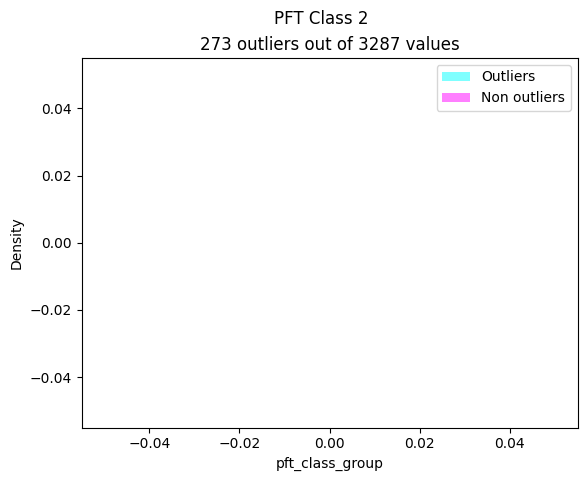

In [89]:
compare_dists(df_ghana_ss_2, anom_ss_2, PFT=2)

In [109]:
df_ghana_ss_2.columns

Index(['pft_class', 'region_cla', 'leaf_off_f', 'urban_prop', 'agbd',
       'agbd_se', 'beam', 'elev_lowes', 'lat_lowest', 'lon_lowest',
       'selected_a', 'shot_numbe', 'sensitivit', 'solar_elev', 'rh98',
       'pattern', 'doy_sin', 'doy_cos', 'date', 'lat_cos', 'lat_sin',
       'lon_cos', 'lon_sin', 'pft_class_group', 'geometry'],
      dtype='object')

#### Comparing Distributions of All Features, by PFT class

In [115]:
def plot_feature_dists(df: pd.DataFrame):
    """
    Plot distribution of every feature segmented by PFT class.

    INPUTS:
    df: dataframe with features, including `pft_class` (pd.DataFrame)
    """
    # set wd
    folder = r"C:\Users\nial\OneDrive\ETH Zürich\Master Thesis\Feature Distribution Plots"
    os.chdir(folder)
    
    # group PFT classes
    class_group_dict = {2:2, 4:4, 9:4, 6:6, 7:6, 8:6}
    df['pft_class_group'] = df.apply(lambda row: class_group_dict[row['pft_class']], axis=1)

    # plot dists for all features
    for feature in df.columns:

        # histograms only work for numbers
        coltype = df[feature].dtype
        if coltype not in ['int64', 'float64']: continue

        # clear figure
        plt.clf()

        # define bins
        bins = 20
        min_x = min(df[feature])
        max_x = max(df[feature])
        bin_edges = np.linspace(min_x, max_x, bins+1)

        # split df into outliers and non-outliers
        df_2 = df[df['pft_class_group'] == 2][feature]
        df_4 = df[df['pft_class_group'] == 4][feature]
        df_6 = df[df['pft_class_group'] == 6][feature]

        # plot histograms
        colours = ['magenta', 'lime', 'maroon']
        plt.hist(df_2, bins=bin_edges, alpha=0.5, label='PFT Group 2', density=True, color=colours[0])
        plt.hist(df_4, bins=bin_edges, alpha=0.5, label='PFT Group 4', density=True, color=colours[1])
        plt.hist(df_6, bins=bin_edges, alpha=0.5, label='PFT Group 6', density=True, color=colours[2])

        # annotate
        plt.suptitle(f'Empirical distributions of {feature} by PFT')
        plt.title(f'PFT 2: {len(df_2)}, PFT 4: {len(df_4)}, PFT 6: {len(df_6)}')
        plt.xlabel(feature)
        plt.ylabel('Density')
        plt.legend()

        fpath = "feature dist for " + feature
        plt.savefig(fpath)          

In [12]:
def plot_feature_dists_no_pft(df: pd.DataFrame):
    """
    Plot distribution of every feature.

    INPUTS:
    df: dataframe with features, including `pft_class` (pd.DataFrame)
    """
    # set wd
    folder = r"C:\Users\nial\OneDrive\ETH Zürich\Master Thesis\Feature Distribution Plots"
    os.chdir(folder)

    # plot dists for all features
    for feature in df.columns:

        # histograms only work for numbers
        coltype = df[feature].dtype
        if coltype not in ['int64', 'float64']: continue

        # clear figure
        plt.clf()

        # define bins
        bins = 50
        min_x = min(df[feature])
        max_x = max(df[feature])
        bin_edges = np.linspace(min_x, max_x, bins+1)

        # plot histograms
        plt.hist(df[feature], bins=bin_edges, alpha=0.5, color='magenta', density=True)

        # annotate
        plt.suptitle(f'Empirical distribution of {feature} in Ghana dataset')
        plt.xlabel(feature)
        plt.ylabel('Density')
        plt.legend()

        fpath = "feature dist for " + feature
        plt.savefig(fpath)  

In [7]:
df_ghana_subsample.columns

Index(['pft_class', 'region_cla', 'leaf_off_f', 'urban_prop', 'agbd',
       'agbd_se', 'beam', 'elev_lowes', 'lat_lowest', 'lon_lowest',
       'selected_a', 'shot_numbe', 'sensitivit', 'solar_elev', 'rh98',
       'pattern', 'doy_sin', 'doy_cos', 'date', 'lat_cos', 'lat_sin',
       'lon_cos', 'lon_sin', 'pft_class_group', 'geometry'],
      dtype='object')

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


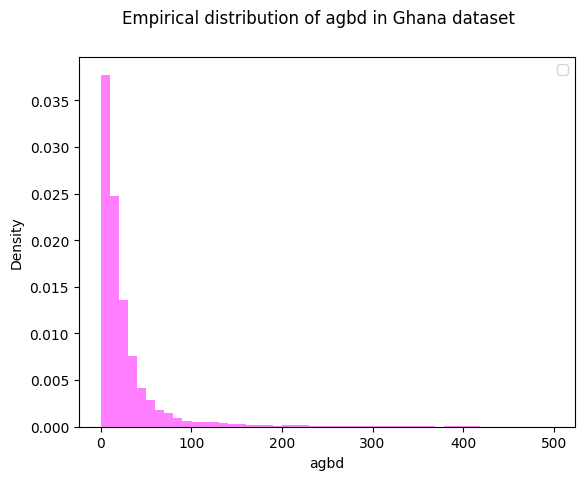

In [13]:
plot_feature_dists_no_pft(df_ghana_subsample[['agbd', 'geometry']])

In [112]:
df_ghana_subsample.columns

Index(['pft_class', 'region_cla', 'leaf_off_f', 'urban_prop', 'agbd',
       'agbd_se', 'beam', 'elev_lowes', 'lat_lowest', 'lon_lowest',
       'selected_a', 'shot_numbe', 'sensitivit', 'solar_elev', 'rh98',
       'pattern', 'doy_sin', 'doy_cos', 'date', 'lat_cos', 'lat_sin',
       'lon_cos', 'lon_sin', 'pft_class_group', 'geometry'],
      dtype='object')

c:\Users\nial\anaconda3\envs\MasterThesis\Lib\site-packages\numpy\lib\histograms.py:885: RuntimeWarning: divide by zero encountered in divide
  return n/db/n.sum(), bin_edges
c:\Users\nial\anaconda3\envs\MasterThesis\Lib\site-packages\numpy\lib\histograms.py:885: RuntimeWarning: invalid value encountered in divide
  return n/db/n.sum(), bin_edges


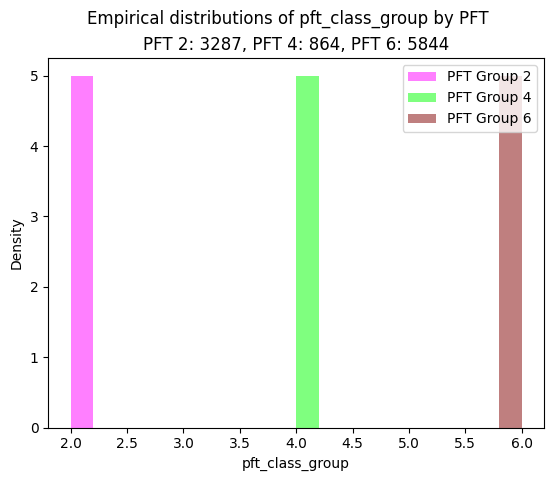

In [116]:
plot_feature_dists(df_ghana_subsample)

### Reverse Engineer Standard Error

We will attempt to reverse engineer the standard error from model parameters, in order to test the hypothesis that model MSE accounts for most of the standard error vs contributions from footprint $i$.

Load h5 file

In [8]:
polybox = r"C:\Users\nial\polybox - Nial Perry (nperry@student.ethz.ch)@polybox.ethz.ch\Nial MT"
h5 = 'GEDI04_A_2019107224731_O01958_01_T02638_02_002_02_V002.h5'
path_h5 = os.path.join(polybox, h5)

with h5py.File(path_h5,'r') as f:
	model_params = f['ANCILLARY']['model_data'][:]

In [49]:
model_params[1:5]

array([(b'DBT_Au', 4, b'EBT_Au', 1, b'sqrt', b'sqrt', b'Snowdon', b'EBT_Au', [70, 98,  0,  0,  0,  0,  0,  0], [1, 2, 0, 0, 0, 0, 0, 0], [11.679041 , 12.020815 ,  0.       ,  0.       ,  0.       ,  0.       ,  0.       ,  0.       ], [[ 2.34774704e+01,  1.41688144e+00, -3.46057057e+00,  0.00000000e+00,  0.00000000e+00], [ 1.41688144e+00,  7.76412129e-01, -8.72368932e-01,  0.00000000e+00,  0.00000000e+00], [-3.46057057e+00, -8.72368932e-01,  1.14751697e+00,  0.00000000e+00,  0.00000000e+00], [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00], [ 0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00,  0.00000000e+00]], [-155.41419983,    7.81670189,    7.70954657,    0.        ,    0.        ], 2.923645 ,  210,  830.58203, 1.0179201 , 3),
       (b'DBT_Eu', 4, b'DBT_Eu', 1, b'sqrt', b'sqrt', b'Snowdon', b'Eu', [70, 98,  0,  0,  0,  0,  0,  0], [1, 2, 0, 0, 0, 0, 0, 0], [11.564601 , 11.903361 ,  0.       ,  0.       ,  0.       ,  0.       , 

A plot to examine the rse by fit stratum. I don't know what `rse` means here, but curious to see its relationship with fit stratum.

In [77]:
fit_strata = list()
rses = list()

for row in model_params:
    fit_stratum = row[7]
    rse = row[-5]
    fit_strata.append(fit_stratum)
    rses.append(rse)

In [78]:
zeros = np.zeros_like(rses)
j = 0.1
jitter = [z + np.random.uniform(-j, j) for z in zeros] 

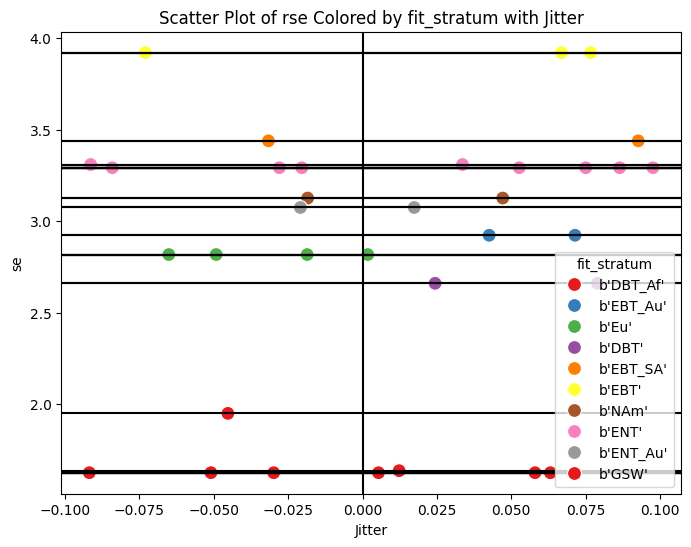

In [92]:
plt.figure(figsize=(8, 6))

# line at x=0
plt.axvline(0, color="black")

# add horizontal lines at unique points 
for i, y in enumerate(rses): 
    plt.axhline(y,color="black")

# scatter
sns.scatterplot(x=jitter, y=rses, hue=fit_strata, palette="Set1", s=100)

# plot labels
plt.xlabel("Jitter")
plt.ylabel("se")
plt.title("Scatter Plot of rse Colored by fit_stratum with Jitter")
plt.legend(title="fit_stratum")
plt.show()

In summary, `rse` is highly associated with `fit_stratum` but the two do not have an 1:N relationship. I.e., other information in `predict_stratum` is used to calculate `rse`.

How we will use this data to reverse engineer:

* From the GEDI paper, PFT classes 5, 6 and 11 correspond to the GSW PFT group
* GSW PFT group requires only RH98 as predictor, which we have in Ghana
* Hence, we will compute $X_i^T \text{Cov}(\beta) X_i$ for each footprint $i$ with `PFT_class` == 6 | `PFT_class` == 11 
* Then we compute $\text{MSE}_k$ = `agbd_se`$^2$ - $X_i^T \text{Cov}(\beta) X_i$ 

From the paper:

"$X_i$ is the row vector of scaled and transformed RH metrics for GEDI footprint $i$"

The scaling is + 100, the transformation is $\sqrt{...}$

Just to confirm that the covariance matrix is the exact same for different prediction strata with the same fit strata:

In [157]:
model_params_af_gsw = model_params[np.array(['GSW_Eu' == x[0].decode() for x in model_params])]
params = [param for param in model_params_af_gsw[0,]]
param_names = [name for name in model_params_af_gsw.dtype.names]
param_dict_eu = dict(zip(param_names, params))
param_dict_eu['vcov']

array([[30.61303329, -2.93952203,  0.        ,  0.        ,  0.        ],
       [-2.93952203,  0.28246009,  0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ],
       [ 0.        ,  0.        ,  0.        ,  0.        ,  0.        ]])

In [190]:
param_dict_eu['vcov'] == param_dict['vcov']

array([[ True,  True,  True,  True,  True],
       [ True,  True,  True,  True,  True],
       [ True,  True,  True,  True,  True],
       [ True,  True,  True,  True,  True],
       [ True,  True,  True,  True,  True]])

In [62]:
model_params_af_gsw = model_params[np.array(['GSW_Af' == x[0].decode() for x in model_params])]
params = [param for param in model_params_af_gsw[0,]]
param_names = [name for name in model_params_af_gsw.dtype.names]
param_dict = dict(zip(param_names, params))
param_dict

In [155]:
param_dict['fit_stratum']

b'GSW'

The global GSW model was fit to predict `agbd` where `PFT_class` is 5, 6 or 11 in Africa. 

In [124]:
param_dict['x_transform']

b'sqrt'

So, $X_i = 
(1 \ \ \sqrt{100 + \text{RH}_{98i}}) $

In [127]:
cov_beta = np.asmatrix(param_dict['vcov'][:2, :2])
cov_beta

matrix([[30.61303329, -2.93952203],
        [-2.93952203,  0.28246009]])

Filter the subsample of Ghana data to the correct PFT classes.

In [133]:
df_ghana_gsw = df_ghana_subsample[df_ghana_subsample["pft_class"].isin([5,6,11])]
df_ghana_gsw = df_ghana_gsw[['agbd','agbd_se','rh98']]
df_ghana_gsw.head(3)

,agbd,agbd_se,rh98
0,28.192062,2.982379,9.200005
1,28.125336,2.982367,9.189999
6,25.582348,2.981975,8.800006


Function to compute $\text{MSE}_k$ for a single row:

In [173]:
def compute_mse_k(row, cov_beta):
    """
    Compute MSEk for a row of df_ghana

    INPUTS: 
    row: from df_ghana
    cov_beta: covariance matrix of estimated model parameters (np.matrix)

    OUTPUTS:
    MSEk: float
    """
    agbd_se, rh98 = row['agbd_se'], row['rh98']
    xi = np.array([1, np.sqrt(rh98 + 100)])
    xCx = xi @ cov_beta @ np.transpose(xi)
    MSEk = agbd_se**2 - xCx
    return MSEk.item(), xCx.item()

In [176]:
df_ghana_gsw['MSEk'] , df_ghana_gsw['xCx'] = zip(*df_ghana_gsw.apply(lambda row: compute_mse_k(row, cov_beta), axis=1))
df_ghana_gsw['agbd_se_est'] = df_ghana_gsw.apply(lambda row: np.sqrt(row['MSEk'] + row['xCx']), axis=1)

In [182]:
np.max(df_ghana_gsw['agbd_se_est'] - df_ghana_gsw['agbd_se'])

4.440892098500626e-16

We have reconstructed the standard error column!

In [188]:
df_plot_gsw = df_ghana_gsw.sample(20, axis=0)
df_plot_gsw.head(3)

,agbd,agbd_se,rh98,MSEk,xCx,MSEk_sqrt,agbd_se_est
3989,1.630395,3.003788,2.879997,8.981230,0.041514,2.996870,3.003788
2799,0.919862,3.008004,2.390001,9.002804,0.045284,3.000467,3.008004
4327,5.818079,2.991744,4.639993,8.919791,0.030744,2.986602,2.991744


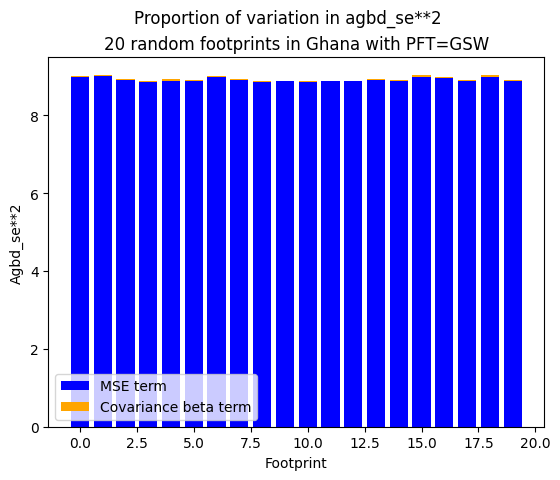

In [189]:
indices = np.arange(len(df_plot_gsw))
plt.bar(indices, df_plot_gsw['MSEk'], color='blue', label='MSEk')
plt.bar(indices, df_plot_gsw['xCx'], bottom=df_plot_gsw['MSEk'], color='orange', label='xCx')
plt.xlabel('Footprint')
plt.ylabel('Agbd_se**2')
plt.suptitle('Proportion of variation in agbd_se**2')
plt.title('20 random footprints in Ghana with PFT=GSW')
plt.legend(["MSE term", "Covariance beta term"])
plt.show()

#### Appendix: Checking the algorithm

It would be helpful to test that the algorithm works before proceeding to take interest in its results. A few unit tests are proposed:

1) For well-behaved x ~ U(0.5, 1.5), running algorithm 1 with theta = 2 should identify few, if any, outliers.

In [ ]:
unif = np.random.uniform(0.5,1.5,9995)
df_no_outliers = pd.DataFrame({"geometry":df_ghana_subsample['geometry'], "agbd": unif})
gdf_no_outliers = gpd.GeoDataFrame(df_no_outliers, geometry='geometry')
outliers_unif = algorithm(gdf_no_outliers, theta=2)
sum(outliers_unif)

127.0

~1.27% of values are classified as outliers, which seems like a reasonable margin for error when k=20 neighbours are considered. How about when k=50? We expect the proportion to go down due to the law of large numbers.

In [ ]:
outliers_unif = algorithm(gdf_no_outliers, theta=2, k=50)
sum(outliers_unif)

76.0

k = 1000?

In [ ]:
outliers_unif = algorithm(gdf_no_outliers, theta=2, k=1000)
sum(outliers_unif)

9.0

As expected, very few outliers are identified when the data is well-behaved, and the number decreases as more neighbours are considered.

2) For well-behaved x ~ U(0.5, 1.5), running algorithm 2 should identify few, if any, outliers.

In [ ]:
outliers_unif = algorithm(gdf_no_outliers, theta=2, alg_no=2)
sum(outliers_unif)

72.0

3) Let's add 100 rows of U(-0.5,0.5) data and see how many are identified as outliers by algorithm 3. For geometries, we randomly pick geometries from the train dataset and add a tiny offset.

In [ ]:
df_geom = preprocess(df_ghana_subsample)
df_geom = df_geom.iloc[0:100]
df_geom['lon'] = df_geom['lon'] + np.random.normal(0, 0.01, len(df_geom))
df_geom['lat'] = df_geom['lat'] + np.random.normal(0, 0.01, len(df_geom))
df_geom['agbd'] = np.random.uniform(-1.5,-0.5,100)

In [ ]:
gdf_no_outliers = preprocess(gdf_no_outliers)
gdf = pd.concat([gdf_no_outliers, df_geom], axis=0)

outliers_100 = algorithm(gdf, theta=2, alg_no=3, m=100)
sum(outliers_100[-100:])

100.0